In [288]:
from dataset import *
from engine import train_one_epoch, evaluate
import torch
import utils
import transforms as T
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def get_transform(train):
    transforms = []
    transforms.append(T.ToTensor())
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

device = torch.device('cpu')

valid_dataset = LabeledDataset(root="../../data/labeled", split="validation", transforms=get_transform(train=False))
index = list(range(200,300))
valid_dataset = torch.utils.data.Subset(valid_dataset, index)
valid_loader = torch.utils.data.DataLoader(valid_dataset, batch_size=1, shuffle=True, num_workers=2, collate_fn=utils.collate_fn)

model = torch.load("FINAL_model_19.pth")
model.eval()
model.to(device)
model18 = torch.load("submit_model_13.pth")
model18.eval()
model18.to(device)
class_list = list(class_dict)

In [289]:
import numpy as np
class UnNormalize(object):
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, tensor):
        """
        Args:
            tensor (Tensor): Tensor image of size (C, H, W) to be normalized.
        Returns:
            Tensor: Normalized image.
        """
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
            # The normalize code -> t.sub_(m).div_(s)
        return tensor

unorm = UnNormalize(mean=(0.4697, 0.4517, 0.3954), std=(0.2305, 0.2258, 0.2261))

# def imshow(img):
#     npimg = unorm(img).numpy()
#     # img = img / 2 + 0.5     # unnormalize
#     npimg = img.numpy()
#     plt.imshow(np.transpose(npimg, (1, 2, 0)))

In [290]:
import matplotlib as mpl

def vis(res1, res2, target, images, class_list, i):
    # dpi = mpl.rcParams['figure.dpi']
    npimg = np.transpose(images.numpy(), (1, 2, 0))
    print(f'{npimg.shape}')
    # height, width, depth = images.shape
    # figsize = width / float(dpi), height / float(dpi)
    fig, ax = plt.subplots(nrows=1, ncols=1, dpi=100)
    ax = fig.add_axes([0, 0, 1, 1])

    ax.imshow(npimg)
    for b, l in zip(target['boxes'], target['labels']):
        b = b.detach().numpy()
        l = l.detach().numpy()
        print(f'true: {b=}, {l=}')
        bbox = patches.Rectangle((b[0], b[1]), b[2]-b[0], b[3]-b[1], linewidth=2, edgecolor='forestgreen', facecolor='none')
        ax.add_patch(bbox)
        plt.text(b[2], b[1], s=f'Truth: {class_list[l]}', fontsize='small', color='white', verticalalignment='top', horizontalalignment='right', bbox={'color': 'forestgreen', 'pad': 0})
        

    for b, l, s in zip(res1['boxes'], res1['labels'], res1['scores']):
        b = b.detach().numpy()
        l = l.detach().numpy()
        s = s.detach().numpy()
        
        if s < 0.9:
            continue
        
        print(f'res18 accuracy: {round(s.item(), 2)}')
        bbox = patches.Rectangle((b[0], b[1]), b[2]-b[0], b[3]-b[1], linewidth=2, edgecolor='royalblue', facecolor='none')
        ax.add_patch(bbox)
        plt.text(b[0], b[1], s=f'res18: {class_list[l]} {round(s.item(), 2)}', fontsize='small', color='white', verticalalignment='top', bbox={'color': 'royalblue', 'pad': 0})
    
    
    for b, l, s in zip(res2['boxes'], res2['labels'], res2['scores']):
        b = b.detach().numpy()
        l = l.detach().numpy()
        s = s.detach().numpy()

        if s < 0.9:
            continue
        
        print(f'res50 accuracy: {round(s.item(), 2)}')
        bbox = patches.Rectangle((b[0], b[1]), b[2]-b[0], b[3]-b[1], linewidth=2, edgecolor='brown', facecolor='none')
        ax.add_patch(bbox)
        plt.text(b[0], b[3], s=f'res50: {class_list[l]} {round(s.item(), 2)}', fontsize='small', color='white', verticalalignment='top', bbox={'color': 'brown', 'pad': 0})
    plt.axis('off')
    # plt.show()
    plt.savefig(f'./bbox_plot/plot_{i}.png')


In [291]:
def predict(model, images):
    images = list(img.to(device) for img in images)
    outputs = model(images)
    outputs = [{k: v.to(torch.device("cpu")) for k, v in t.items()} for t in outputs]
    outputs = outputs[0]
    # res = {target["image_id"].item(): output for target, output in zip(targets, outputs)}
    return outputs


In [292]:
images, targets = next(iter(valid_loader))


(500, 299, 3)
true: b=array([ 56.,  66., 276., 371.], dtype=float32), l=array(3, dtype=int64)
res18 accuracy: 0.91
res50 accuracy: 0.93
(1232, 1476, 3)
true: b=array([ 150.,  166., 1377., 1148.], dtype=float32), l=array(76, dtype=int64)
(500, 375, 3)
true: b=array([  5.,  12., 296., 425.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.97
res50 accuracy: 0.98
(225, 225, 3)
true: b=array([  0.,  10., 219., 224.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.99
res50 accuracy: 0.99
(500, 375, 3)
true: b=array([ 43.,  20., 343., 498.], dtype=float32), l=array(39, dtype=int64)
(323, 216, 3)
true: b=array([ 16., 108., 215., 319.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.99
res50 accuracy: 0.99
(300, 350, 3)
true: b=array([ 36.,  23., 329., 288.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.99
res50 accuracy: 0.99
(335, 500, 3)
true: b=array([  2.,  65., 378., 334.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.99
res50 acc

C:\Users\zheng\AppData\Local\Temp/ipykernel_20540/3845693319.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(nrows=1, ncols=1, dpi=100)


(375, 500, 3)
true: b=array([114., 100., 314., 294.], dtype=float32), l=array(93, dtype=int64)
(375, 500, 3)
true: b=array([  0.,  67., 463., 374.], dtype=float32), l=array(1, dtype=int64)
res50 accuracy: 0.99
(375, 500, 3)
true: b=array([  1., 343., 170., 362.], dtype=float32), l=array(54, dtype=int64)
res18 accuracy: 0.91
res50 accuracy: 0.94
(500, 375, 3)
true: b=array([ 83.,  92., 272., 498.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.99
res50 accuracy: 0.99
(73, 128, 3)
true: b=array([  5.,   2., 124.,  67.], dtype=float32), l=array(4, dtype=int64)
true: b=array([44., 15., 78., 68.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.94
res50 accuracy: 0.9
(500, 333, 3)
true: b=array([ 87.,  93., 294., 446.], dtype=float32), l=array(4, dtype=int64)
res18 accuracy: 0.99
res50 accuracy: 1.0
(325, 500, 3)
true: b=array([ 41.,  70., 436., 287.], dtype=float32), l=array(1, dtype=int64)
res18 accuracy: 1.0
res50 accuracy: 1.0
(375, 500, 3)
true: b=array([ 58.,   0

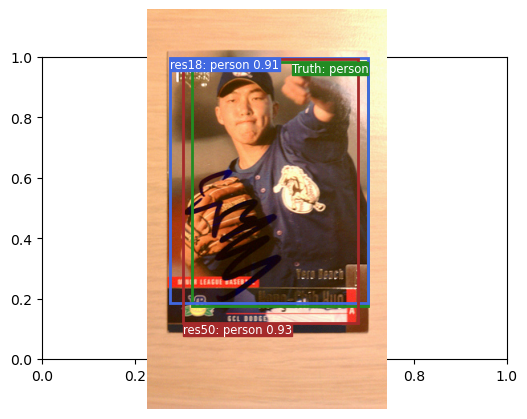

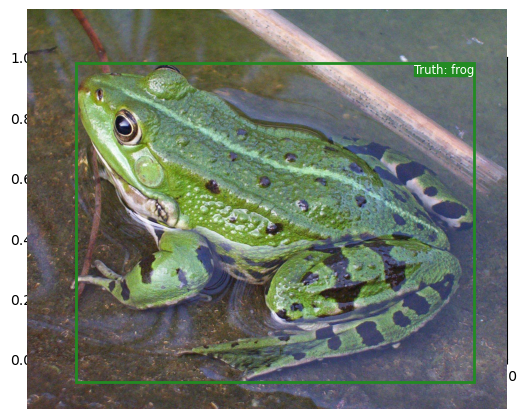

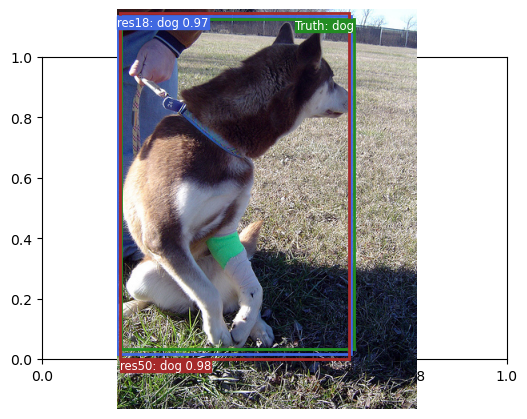

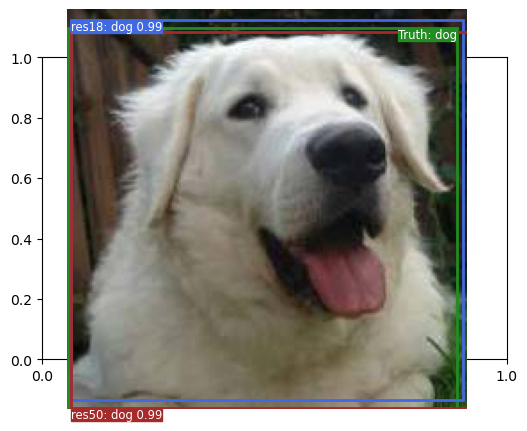

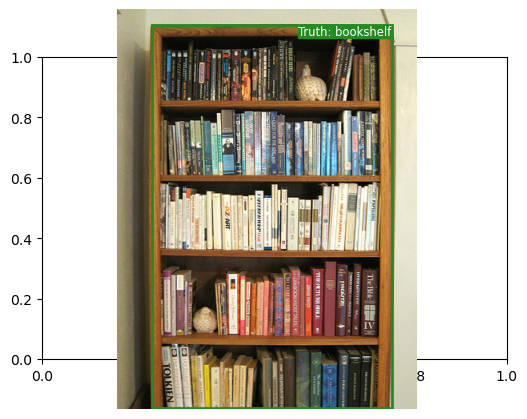

...

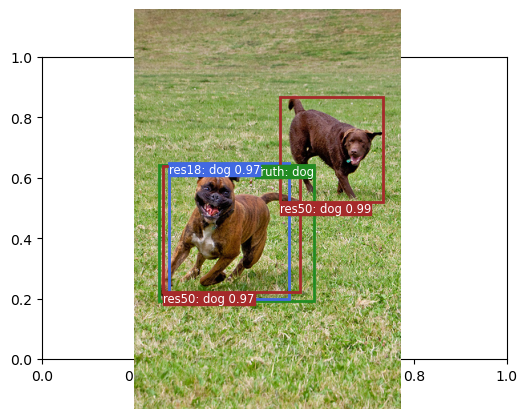

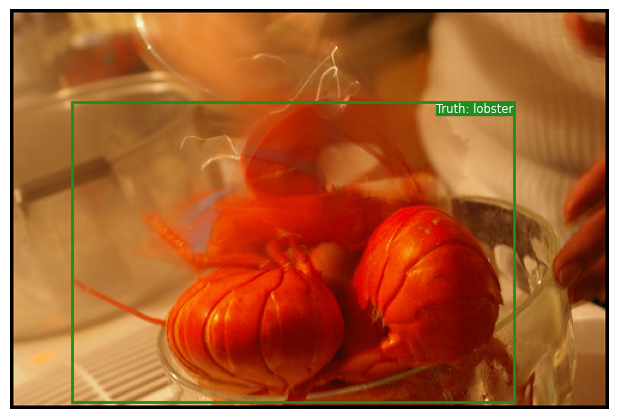

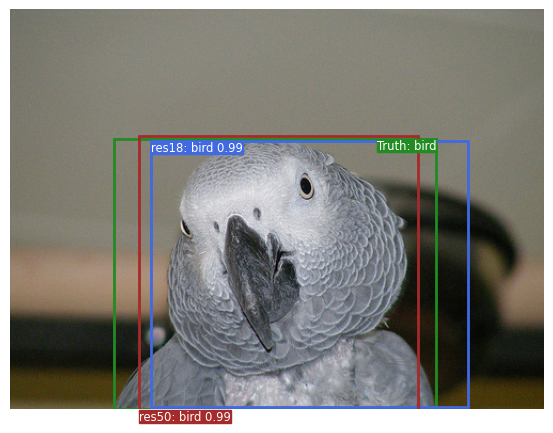

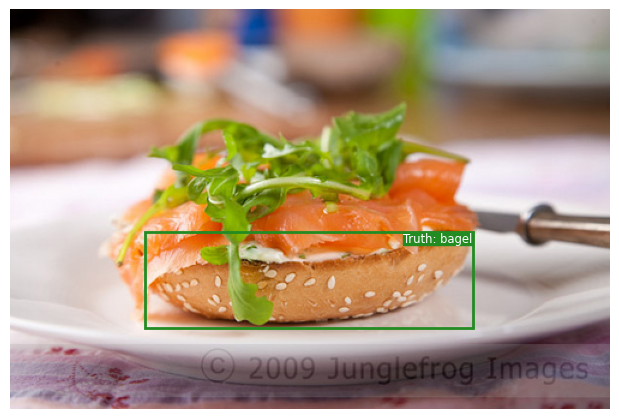

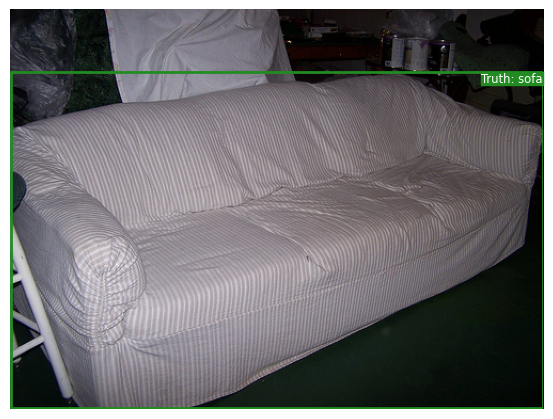

In [293]:
for i, (images, targets) in enumerate(valid_loader):
    out18 = predict(model18, images)
    out50 = predict(model, images)
    vis(out18, out50, targets[0], images[0], class_list, i+200)